In [1]:
from matplotlib import pyplot as plt
from matplotlib.dates import DateFormatter
import numpy as np
import xarray as xr
import pandas as pd
import scipy
from datetime import datetime, timedelta
import time
import seaborn
import matplotlib.dates as mdates
import bottleneck as bn
import PyCO2SYS as pyco2
import gsw
import math
import netCDF4 as nc
import requests

# import chemO_funcs #import o2sat
from importlib import reload
import warnings
warnings.filterwarnings('ignore')
import cartopy.crs as ccrs
import cartopy.mpl.ticker as cticker
# %run ./chemO_funcs.py

## Open all GFDL data

In [2]:
phgfdl = pd.read_csv('/Users/akbaskind/Desktop/YoE/phYOE_gfdl.csv')
omegagfdl = pd.read_csv('/Users/akbaskind/Desktop/YoE/omegaYOE_gfdl.csv')
fco2gfdl = pd.read_csv('/Users/akbaskind/Desktop/YoE/fco2YOE_gfdl.csv')

phbuoy = pd.read_csv('/Users/akbaskind/Desktop/YoE/phYOE_buoy.csv')
omegabuoy = pd.read_csv('/Users/akbaskind/Desktop/YoE/omegaYOE_buoy.csv')
fco2buoy = pd.read_csv('/Users/akbaskind/Desktop/YoE/fco2YOE_buoy.csv')

phsocat = pd.read_csv('/Users/akbaskind/Desktop/YoE/phYOE_091423.csv')
omegasocat = pd.read_csv('/Users/akbaskind/Desktop/YoE/omegaYOE_091423.csv')
fco2socat = pd.read_csv('/Users/akbaskind/Desktop/YoE/fco2YOE_091423.csv')

In [3]:
pink = '#ff6289'
purple = '#C79FEF'
blue = '#82e9ff'
green = '#C1F80A'

# Greens
caribbean_green = '#00cc99'
emerald = '#319177'
crayola_green = '#1cac78'
jade = '#00a86b'
kelly = '#4cbb17'
yellowgreen = '#9acd32'

# Blues
french_sky_blue = '#77b5fe'
opal = '#a8c3bc'
baby_blue = '#89cff0'
tiffany_blue = '#0abab5'
cornflower = '#6495ed'

# Pinks
hollywood_cerise = '#f400a1'
baker_miller = '#ff91af'
wild_strawberry = '#ff43a4'

# Purples
iris = '#5a4fcf'
orchid = '#9932cc'
amethyst = '#9966cc'
wisteria = '#c9a0dc'

# Oranges
neon_carrot = '#ffa343'
gamboge = '#e49b0f'
carrot = '#ed9121'

# Yellows
sunglow = '#ffcc33'
bitter_lemon = '#cae00d'
pantone_yellow = '#fedf00'

# Reds
candy_apple = '#e2062c'
carmine = '#eb4c42'
coquelicot = '#ff3800'

# Fig GFDL Regions

In [4]:
regs = pd.read_csv('/Users/akbaskind/Desktop/YoE/regions.csv')
temp = {'Region':[], 
        'SOCAT Ω YOE':[], 'SOCAT pH YOE':[], 'SOCAT fCO2 YOE':[], 
        'Buoy Ω YOE':[], 'Buoy pH YOE':[], 'Buoy fCO2 YOE':[], 
        'GFDL Ω YOE':[], 'GFDL pH YOE':[], 'GFDL fCO2 YOE':[]}
for i in regs.index:
    lon = regs['xi'][i]
    lon = lon % 360
    lat = regs['yi'][i]
    dx = regs['dx'][i]
    dy = regs['dy'][i]
    temp['Region'].append(regs['Region'][i])

    # SOCAT adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_091423.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    O = omega['YOE'].mean()
    O = round(O)
    temp['SOCAT Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_091423.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    P = ph['YOE'].mean()
    P = round(P)
    temp['SOCAT pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_091423.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    F = fco2['YOE'].mean()
    F = round(F)
    temp['SOCAT fCO2 YOE'].append(F)
    
    # Buoy adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_buoy.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    O = omega['YOE'].mean()
    O = round(O)
    temp['Buoy Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_buoy.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    P = ph['YOE'].mean()
    P = round(P)
    temp['Buoy pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_buoy.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    F = fco2['YOE'].mean()
    F = round(F)
    temp['Buoy fCO2 YOE'].append(F)
    
    # GFDL
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_gfdl.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    O = omega['YOE'].mean()
    O = round(O)
    temp['GFDL Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_gfdl.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    P = ph['YOE'].mean()
    P = round(P)
    temp['GFDL pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_gfdl.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    F = fco2['YOE'].mean()
    F = round(F)
    temp['GFDL fCO2 YOE'].append(F)
regions = pd.DataFrame(temp)
regions

,Region,SOCAT Ω YOE,SOCAT pH YOE,SOCAT fCO2 YOE,Buoy Ω YOE,Buoy pH YOE,Buoy fCO2 YOE,GFDL Ω YOE,GFDL pH YOE,GFDL fCO2 YOE
0,SANT,1996,1906,1950,2031,1960,1979,1983,1893,1898
1,SSTC,2005,1939,1968,2037,1982,1993,2000,1929,1939
2,WARM,1972,1949,1971,2009,1991,1998,1954,1938,1950
3,PEQD,1980,1970,1982,2017,2005,2009,1963,1964,1974
4,NPTG,1963,1958,1972,1999,1995,1999,1942,1951,1957
5,SPSG,1973,1965,1979,2004,2001,2004,1957,1959,1966
6,SATL,1964,1982,1987,1998,2012,2013,1948,1980,1988
7,ARCT,2009,1954,1977,2035,1992,2000,2004,1944,1952
8,NATR,1972,1978,1984,2003,2009,2010,1955,1975,1982
9,WTRA,1955,1948,1968,1996,1990,1995,1930,1938,1946


In [5]:
def addregions(ax, txt):
    # SANT
    xi = -17.2
    yi = -48.6
    xs = [xi - 15, xi + 15, xi + 15, xi - 15, xi - 15]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][0]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # SSTC
    xi = -7.1
    yi = -39.4
    xs = [xi - 15, xi + 15, xi + 15, xi - 15, xi - 15]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][1]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # WARM
    xi = 141.2
    yi = 5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][2]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # PEQD
    xi = -119.4
    yi = 2.5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 2.5, yi + 2.5, yi - 2.5, yi - 2.5, yi + 2.5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][3]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # NPTG
    xi = -158.4
    yi = 15.5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][4]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # SPSG
    xi = -158.4
    yi = -15.5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][5]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # SATL
    xi = -18
    yi = -20.5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][6]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # ARCT
    xi = -45
    yi = 55
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][7]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # NATR
    xi = -40
    yi = 15.5
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][8]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # WTRA
    xi = -40
    yi = 5
    xs = [xi - 10, xi + 10, xi + 10, xi - 10, xi - 10]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][9]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # MONS
    xi = 70
    yi = -2.7
    xs = [xi - 10, xi + 10, xi + 10, xi - 10, xi - 10]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][10]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # BERS
    xi = 150
    yi = 50
    xs = [xi - 6, xi + 6, xi + 6, xi - 6, xi - 6]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][11]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    # BPRL
    xi = 50
    yi = 78
    xs = [xi - 7, xi + 7, xi + 7, xi - 7, xi - 7]
    ys = [yi + 5, yi + 5, yi - 5, yi - 5, yi + 5]
    ax.plot(xs, ys, color="blue")
    label = regions[txt][12]
    ax.annotate(label, xy=(xi,yi), xytext=(xi-7,yi))
    

In [26]:
omega.keys()

Index(['Unnamed: 0', 'Lat', 'Lon', '1850 Omega', 'YOE Projected Omega',
       'YOE Actual Omega from polynomial', 'YOE'],
      dtype='object')

In [32]:
regs = pd.read_csv('/Users/akbaskind/Desktop/YoE/regions.csv')
temp = {'Region':[], 
        'SOCAT Ω YOE':[], 'SOCAT pH YOE':[], 'SOCAT fCO2 YOE':[], 
        'Buoy Ω YOE':[], 'Buoy pH YOE':[], 'Buoy fCO2 YOE':[], 
        'GFDL Ω YOE':[], 'GFDL pH YOE':[], 'GFDL fCO2 YOE':[]}
for i in regs.index:
    lon = regs['xi'][i]
    lon = lon % 360
    lat = regs['yi'][i]
    dx = regs['dx'][i]
    dy = regs['dy'][i]
    temp['Region'].append(regs['Region'][i])

    # SOCAT adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_091423.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE Projected Omega']
    Oi = omega['1850 Omega']
    dO = Of - Oi
    O = dO.mean()
    O = round(O,2)
    temp['SOCAT Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_091423.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = 10**(-ph['YOE Projected pH'])
    Pi = 10**(-ph['1850 pH'])
    dP = Pf - Pi
    P = dP.mean()
    P = round(P,11)*1e9
    P = round(P,3)
    temp['SOCAT pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_091423.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE Projected fCO2']
    Fi = fco2['1850 fCO2']
    dF = Ff - Fi
    F = dF.mean()
    F = round(F,2)
    temp['SOCAT fCO2 YOE'].append(F)
    
    # Buoy adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_buoy.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE Projected Omega']
    Oi = omega['1850 Omega']
    dO = Of - Oi
    O = dO.mean()
    O = round(O,2)
    temp['Buoy Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_buoy.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = 10**(-ph['YOE Projected pH'])
    Pi = 10**(-ph['1850 pH'])
    dP = Pf - Pi
    P = dP.mean()
    P = round(P,11)*1e9
    P = round(P,3)
    temp['Buoy pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_buoy.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE Projected fCO2']
    Fi = fco2['1850 fCO2']
    dF = Ff - Fi
    F = dF.mean()
    F = round(F,2)
    temp['Buoy fCO2 YOE'].append(F)
    
    # GFDL
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_gfdl.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE Projected Omega']
    Oi = omega['1850 Omega']
    dO = Of - Oi
    O = dO.mean()
    O = round(O,2)
    temp['GFDL Ω YOE'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_gfdl.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = 10**(-ph['YOE Projected pH'])
    Pi = 10**(-ph['1850 pH'])
    dP = Pf - Pi
    P = dP.mean()
    P = round(P,11)*1e9
    P = round(P,3)
    temp['GFDL pH YOE'].append(P)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_gfdl.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE Projected fCO2']
    Fi = fco2['1850 fCO2']
    dF = Ff - Fi
    F = dF.mean()
    F = round(F,2)
    temp['GFDL fCO2 YOE'].append(F)
regions = pd.DataFrame(temp)
regions

,Region,SOCAT Ω YOE,SOCAT pH YOE,SOCAT fCO2 YOE,Buoy Ω YOE,Buoy pH YOE,Buoy fCO2 YOE,GFDL Ω YOE,GFDL pH YOE,GFDL fCO2 YOE
0,SANT,-0.30,0.25,25.77,-0.54,0.62,42.27,-0.24,0.16,9.72
1,SSTC,-0.44,0.45,34.76,-0.74,0.95,60.02,-0.40,0.39,24.20
2,WARM,-0.26,0.56,40.60,-0.49,1.16,71.02,-0.20,0.49,33.43
3,PEQD,-0.30,0.78,50.16,-0.53,1.52,88.95,-0.24,0.73,48.37
4,NPTG,-0.24,0.62,41.55,-0.44,1.26,73.42,-0.17,0.56,35.13
5,SPSG,-0.30,0.70,44.10,-0.51,1.38,78.46,-0.25,0.64,39.24
6,SATL,-0.27,0.93,55.40,-0.49,1.77,100.76,-0.21,0.91,57.43
7,ARCT,-0.42,0.52,36.90,-0.71,1.05,64.25,-0.38,0.46,27.65
8,NATR,-0.27,0.85,50.87,-0.46,1.62,91.82,-0.21,0.81,50.14
9,WTRA,-0.20,0.54,39.77,-0.40,1.12,68.50,-0.14,0.48,31.48


In [39]:
round(regions['SOCAT pH YOE'][0],11)

2.5e-10

In [28]:
OG_regions = regions
regions = regions2

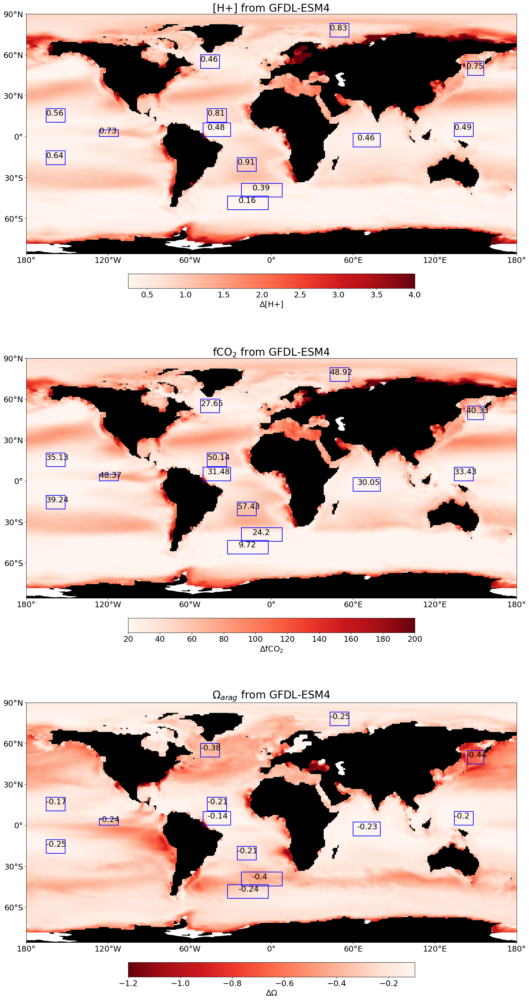

In [33]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phgfdl
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = 10**(-ph['YOE Projected pH']) - 10**(-ph['1850 pH'])
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C*1e9, cmap = 'Reds', vmin  = 0.25, vmax = 4)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆[H+]')
ax.set_title('[H+] from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
addregions(ax, 'GFDL pH YOE')


# FCO2
ax = axarr[1]
fco2 = fco2gfdl
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = fco2['YOE Projected fCO2'] - fco2['1850 fCO2']
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'Reds', vmin  = 20, vmax = 200)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆fCO$_2$')
ax.set_title('fCO$_2$ from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'GFDL fCO2 YOE'
addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegagfdl
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = omega['YOE Projected Omega'] - omega['1850 Omega']
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'Reds_r', vmin  = -1.2, vmax = -0.1)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆Ω')
ax.set_title('Ω$_{arag}$ from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'GFDL Ω YOE'
addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/YOEchange_GFDL_label2.png', bbox_inches='tight')

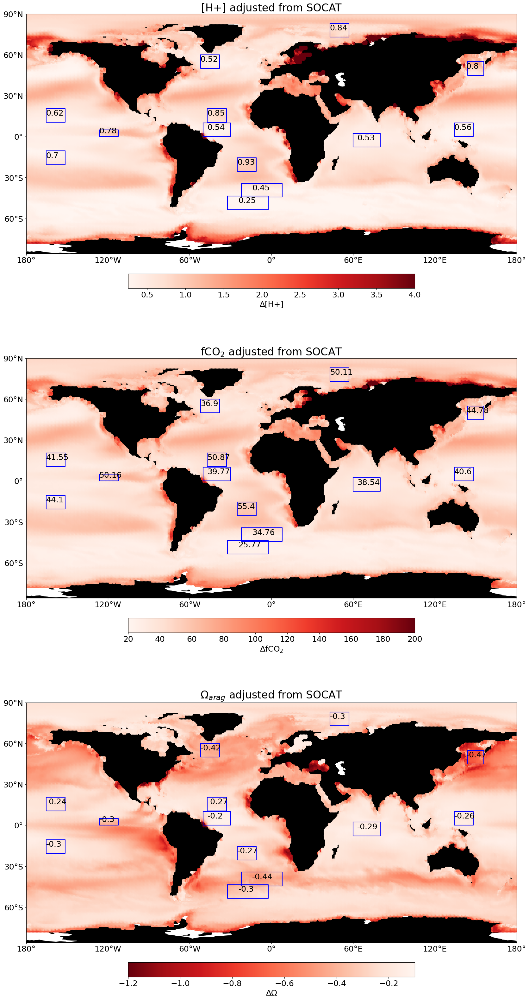

In [34]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phsocat
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = 10**(-ph['YOE Projected pH']) - 10**(-ph['1850 pH'])
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C*1e9, cmap = 'Reds', vmin  = 0.25, vmax = 4)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆[H+]')
ax.set_title('[H+] adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
addregions(ax, 'SOCAT pH YOE')


# FCO2
ax = axarr[1]
fco2 = fco2socat
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = fco2['YOE Projected fCO2'] - fco2['1850 fCO2']
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'Reds', vmin  = 20, vmax = 200)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆fCO$_2$')
ax.set_title('fCO$_2$ adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'SOCAT fCO2 YOE'
addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegasocat
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = omega['YOE Projected Omega'] - omega['1850 Omega']
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'Reds_r', vmin  = -1.2, vmax = -0.1)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆Ω')
ax.set_title('Ω$_{arag}$ adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'SOCAT Ω YOE'
addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/YOEchange_SOCAT_label2.png', bbox_inches='tight')

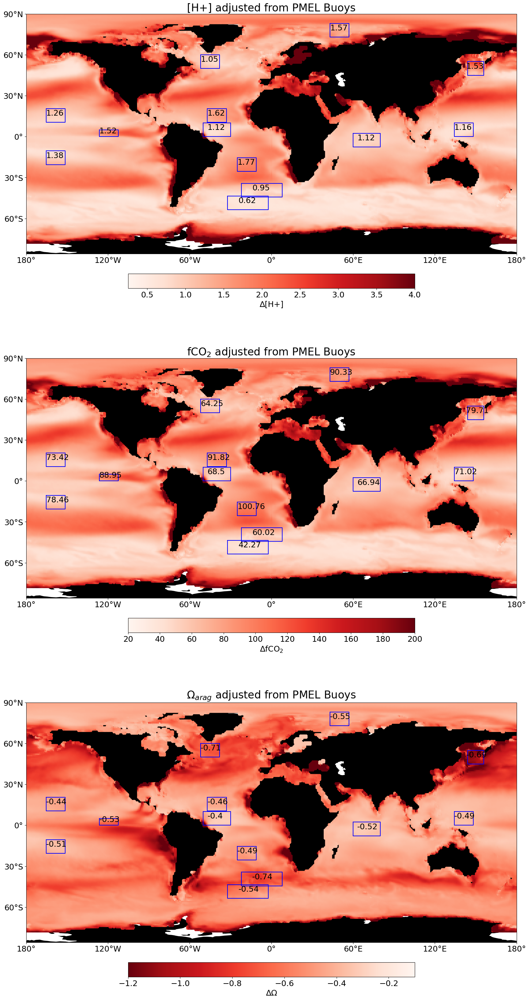

In [35]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phbuoy
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = 10**(-ph['YOE Projected pH']) - 10**(-ph['1850 pH'])
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C*1e9, cmap = 'Reds', vmin  = 0.25, vmax = 4)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆[H+]')
ax.set_title('[H+] adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
addregions(ax, 'Buoy pH YOE')


# FCO2
ax = axarr[1]
fco2 = fco2buoy
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = fco2['YOE Projected fCO2'] - fco2['1850 fCO2']
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'Reds', vmin  = 20, vmax = 200)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆fCO$_2$')
ax.set_title('fCO$_2$ adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'Buoy fCO2 YOE'
addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegabuoy
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = omega['YOE Projected Omega'] - omega['1850 Omega']
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'Reds_r', vmin  = -1.2, vmax = -0.1)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∆Ω')
ax.set_title('Ω$_{arag}$ adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'Buoy Ω YOE'
addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/YOEchange_buoy_label2.png', bbox_inches='tight')

# Change in temperature
## GFDL

In [21]:
regs = pd.read_csv('/Users/akbaskind/Desktop/YoE/regions.csv')
temp = {'Region':[], 
        'SOCAT Ω YOE ∆T/∆t':[], 'SOCAT pH YOE ∆T/∆t':[], 'SOCAT pH YOE ∆T/∆t error':[], 'SOCAT fCO2 YOE ∆T/∆t':[], 
        'Buoy Ω YOE ∆T/∆t':[], 'Buoy pH YOE ∆T/∆t':[], 'Buoy pH YOE ∆T/∆t error':[], 'Buoy fCO2 YOE ∆T/∆t':[], 
        'GFDL Ω YOE ∆T/∆t':[], 'GFDL pH YOE ∆T/∆t':[], 'GFDL pH YOE ∆T/∆t error':[], 'GFDL fCO2 YOE ∆T/∆t':[]}
for i in regs.index:
    lon = regs['xi'][i]
    lon = lon % 360
    lat = regs['yi'][i]
    dx = regs['dx'][i]
    dy = regs['dy'][i]
    temp['Region'].append(regs['Region'][i])

    # SOCAT adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_091423.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE T']
    Oi = omega['1850 T']
    t = omega['YOE']
    dO = (Of - Oi) #/(t-1850)
    O = dO.mean()
    O = round(O,4)
    temp['SOCAT Ω YOE ∆T/∆t'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_091423.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = ph['YOE T']
    Pi = ph['1850 T']
    t = ph['YOE']
    dP = (Pf - Pi) #/(t-1850)
    P = dP.mean()
    Perr = dP.std(ddof = 1)
    P = round(P,4)
    temp['SOCAT pH YOE ∆T/∆t'].append(P)
    temp['SOCAT pH YOE ∆T/∆t error'].append(Perr)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_091423.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE T']
    Fi = fco2['1850 T']
    t = fco2['YOE']
    dF = (Ff - Fi) #/(t-1850)
    F = dF.mean()
    F = round(F,4)
    temp['SOCAT fCO2 YOE ∆T/∆t'].append(F)
    
    # Buoy adjustment
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_buoy.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE T']
    Oi = omega['1850 T']
    t = omega['YOE']
    dO = (Of - Oi) #/(t-1850)
    O = dO.mean()
    O = round(O,4)
    temp['Buoy Ω YOE ∆T/∆t'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_buoy.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = ph['YOE T']
    Pi = ph['1850 T']
    t = ph['YOE']
    dP = (Pf - Pi) #/(t-1850)
    P = dP.mean()
    Perr = dP.std(ddof = 1)
    P = round(P,4)
    temp['Buoy pH YOE ∆T/∆t'].append(P)
    temp['Buoy pH YOE ∆T/∆t error'].append(Perr)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_buoy.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE T']
    Fi = fco2['1850 T']
    t = fco2['YOE']
    dF = (Ff - Fi) #/(t-1850)
    F = dF.mean()
    F = round(F,4)
    temp['Buoy fCO2 YOE ∆T/∆t'].append(F)
    
    # GFDL
    ## Omega
    file = '/Users/akbaskind/Desktop/YoE/omegaYOE_gfdl.csv'
    omega = pd.read_csv(file)
    omega = omega.where(omega['Lat'] < lat + dy).where(omega['Lat'] > lat - dy).dropna()
    if lon != 50:
        omega = omega.where(omega['Lon'] > lon - dx).where(omega['Lat'] < lon + dx).dropna()
    else:
        omega = omega.where(omega['Lon'] < lon + dx).where(omega['Lat'] > lon - dx).dropna()
    Of = omega['YOE T']
    Oi = omega['1850 T']
    t = omega['YOE']
    dO = (Of - Oi) #/(t-1850)
    O = dO.mean()
    O = round(O,4)
    temp['GFDL Ω YOE ∆T/∆t'].append(O)
    ## pH
    file = '/Users/akbaskind/Desktop/YoE/pHYOE_gfdl.csv'
    ph = pd.read_csv(file)
    ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
    if lon != 50:
        ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
    else:
        ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
    Pf = ph['YOE T']
    Pi = ph['1850 T']
    t = ph['YOE']
    dP = (Pf - Pi) #/(t-1850)
    P = dP.mean()
    Perr = dP.std(ddof=1)
    P = round(P,4)
    temp['GFDL pH YOE ∆T/∆t'].append(P)
    temp['GFDL pH YOE ∆T/∆t error'].append(Perr)
    ## fCO2
    file = '/Users/akbaskind/Desktop/YoE/fco2YOE_gfdl.csv'
    fco2 = pd.read_csv(file)
    fco2 = fco2.where(fco2['Lat'] < lat + dy).where(fco2['Lat'] > lat - dy).dropna()
    if lon != 50:
        fco2 = fco2.where(fco2['Lon'] > lon - dx).where(fco2['Lat'] < lon + dx).dropna()
    else:
        fco2 = fco2.where(fco2['Lon'] < lon + dx).where(fco2['Lat'] > lon - dx).dropna()
    Ff = fco2['YOE T']
    Fi = fco2['1850 T']
    t = fco2['YOE']
    dF = (Ff - Fi) #/(t-1850)
    F = dF.mean()
    F = round(F,4)
    temp['GFDL fCO2 YOE ∆T/∆t'].append(F)
regions = pd.DataFrame(temp)
regions

,Region,SOCAT Ω YOE ∆T/∆t,SOCAT pH YOE ∆T/∆t,SOCAT pH YOE ∆T/∆t error,SOCAT fCO2 YOE ∆T/∆t,Buoy Ω YOE ∆T/∆t,Buoy pH YOE ∆T/∆t,Buoy pH YOE ∆T/∆t error,Buoy fCO2 YOE ∆T/∆t,GFDL Ω YOE ∆T/∆t,GFDL pH YOE ∆T/∆t,GFDL pH YOE ∆T/∆t error,GFDL fCO2 YOE ∆T/∆t
0,SANT,0.3824,0.2510,0.193470,-0.2472,0.7693,-0.2380,0.178447,0.2823,0.3444,0.2425,0.211044,0.2694
1,SSTC,0.6982,0.0169,0.337505,0.0252,0.9535,0.2154,0.488239,0.5383,0.5284,0.0869,0.348016,0.0801
2,WARM,0.3486,0.2387,0.203871,0.2226,0.7738,0.4451,0.416137,0.5465,0.2791,0.2044,0.187485,0.2505
3,PEQD,0.4483,0.2288,0.271737,0.2947,0.8499,0.6506,0.611251,0.7600,0.3226,0.1930,0.197124,0.2906
4,NPTG,0.1831,0.1923,0.153226,0.1734,0.4761,0.4187,0.323262,0.4884,0.2046,0.1890,0.145976,0.1970
5,SPSG,0.3726,0.2798,0.265969,0.3481,0.5047,0.5222,0.469589,0.5963,0.3681,0.2402,0.257134,0.2859
6,SATL,0.2665,0.3170,0.059143,0.3297,0.3435,0.7471,0.219033,0.8223,0.3073,0.3166,0.059052,0.3140
7,ARCT,0.4692,0.4629,0.516998,0.0388,0.4241,0.4568,0.720421,0.6668,0.5023,0.4275,0.580670,0.3766
8,NATR,0.2871,0.2386,0.241638,0.2426,0.6231,0.7223,0.354952,0.7277,0.3219,0.2350,0.222579,0.2479
9,WTRA,0.2178,0.1815,0.122068,0.1659,0.3863,0.3138,0.248700,0.3762,0.1973,0.1756,0.117416,0.1860


In [9]:
0.0590

,Region,xi,yi,dx,dy
0,SANT,-17.2,-48.6,15,5.0
1,SSTC,-7.1,-39.4,15,5.0
2,WARM,141.2,5.0,7,5.0
3,PEQD,-119.4,2.5,7,2.5
4,NPTG,-158.4,15.5,7,5.0
5,SPSG,-158.4,-15.5,7,5.0
6,SATL,-18.0,-20.5,7,5.0
7,ARCT,-45.0,55.0,7,5.0
8,NATR,-40.0,15.5,7,5.0
9,WTRA,-40.0,5.0,10,5.0


In [25]:
i = 11
lon = regs['xi'][i]
lon = lon % 360
lat = regs['yi'][i]
dx = regs['dx'][i]
dy = regs['dy'][i]
file = '/Users/akbaskind/Desktop/YoE/pHYOE_091423.csv'
ph = pd.read_csv(file)
ph = ph.where(ph['Lat'] < lat + dy).where(ph['Lat'] > lat - dy).dropna()
if lon != 50:
    ph = ph.where(ph['Lon'] > lon - dx).where(ph['Lat'] < lon + dx).dropna()
else:
    ph = ph.where(ph['Lon'] < lon + dx).where(ph['Lat'] > lon - dx).dropna()
Pf = ph['YOE T']
Pi = ph['1850 T']
t = ph['YOE']
dP = (Pf - Pi)/(t-1850)
P = dP.mean()
P = round(P,4)
P

0.0008

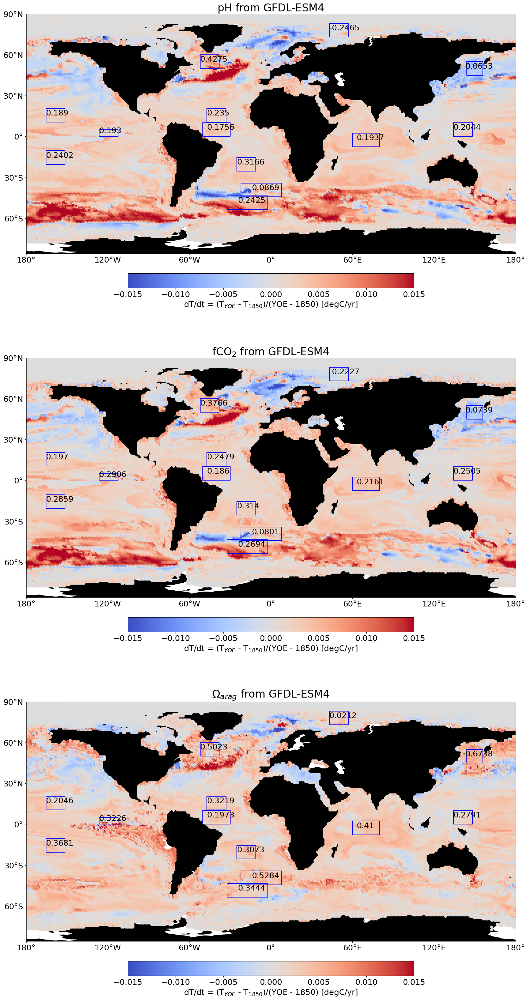

In [22]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phgfdl
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = (ph['YOE T'] - ph['1850 T'])/(ph['YOE']-1850)
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C, cmap = 'coolwarm', vmin  = -0.015, vmax = 0.015)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dT/dt = (T$_{YOE}$ - T$_{1850}$)/(YOE - 1850) [degC/yr]')
ax.set_title('pH from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
addregions(ax, 'GFDL pH YOE ∆T/∆t')


# FCO2
ax = axarr[1]
fco2 = fco2gfdl
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = (fco2['YOE T'] - fco2['1850 T'])/(fco2['YOE']-1850)
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'coolwarm', vmin  = -0.015, vmax = 0.015)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dT/dt = (T$_{YOE}$ - T$_{1850}$)/(YOE - 1850) [degC/yr]')
ax.set_title('fCO$_2$ from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'GFDL fCO2 YOE ∆T/∆t'
addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegagfdl
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = (omega['YOE T'] - omega['1850 T'])/(omega['YOE']-1850)
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'coolwarm', vmin  = -0.015, vmax = 0.015)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dT/dt = (T$_{YOE}$ - T$_{1850}$)/(YOE - 1850) [degC/yr]')
ax.set_title('Ω$_{arag}$ from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
txt = 'GFDL Ω YOE ∆T/∆t'
addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/Tchange_GFDL_meanlabel.png', bbox_inches='tight')

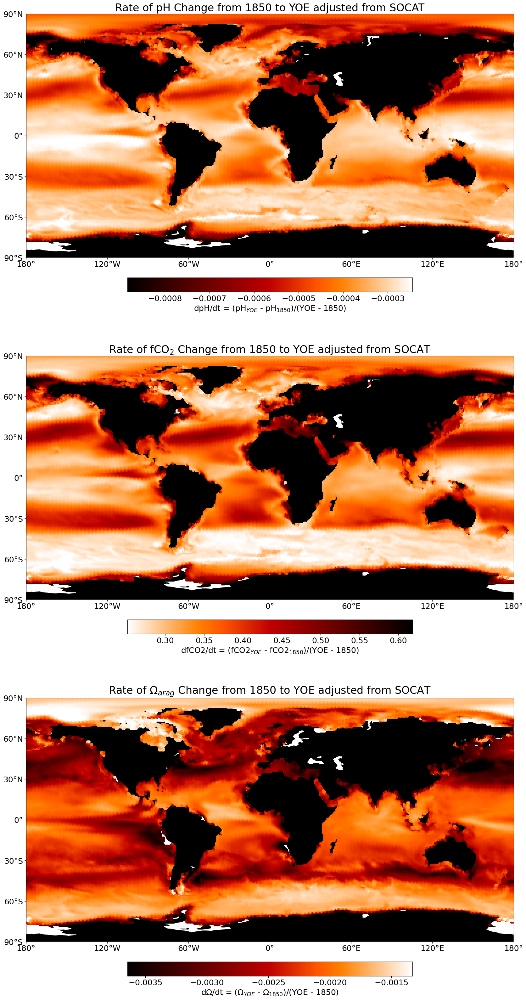

In [15]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phsocat
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = (ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dpH/dt = (pH$_{YOE}$ - pH$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of pH Change from 1850 to YOE adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
# addregions(ax, 'GFDL pH YOE ∆T/∆t')


# FCO2
ax = axarr[1]
fco2 = fco2socat
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = (fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'gist_heat_r', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dfCO2/dt = (fCO2$_{YOE}$ - fCO2$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of fCO$_2$ Change from 1850 to YOE adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL fCO2 YOE ∆T/∆t'
# addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegasocat
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = (omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dΩ/dt = (Ω$_{YOE}$ - Ω$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of Ω$_{arag}$ Change from 1850 to YOE adjusted from SOCAT', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL Ω YOE ∆T/∆t'
# addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/rateofchange_SOCAT_label.png', bbox_inches='tight')

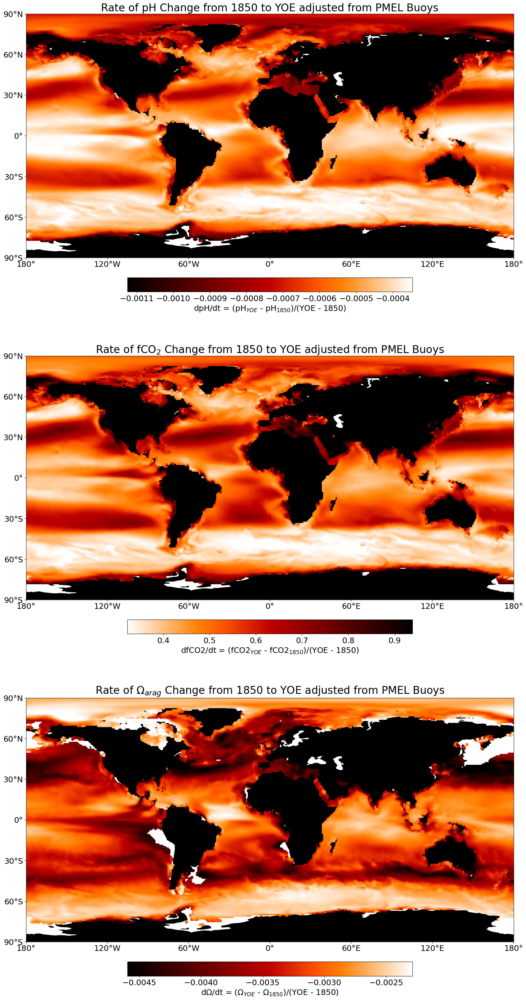

In [16]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phbuoy
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = (ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dpH/dt = (pH$_{YOE}$ - pH$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of pH Change from 1850 to YOE adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
# addregions(ax, 'GFDL pH YOE ∆T/∆t')


# FCO2
ax = axarr[1]
fco2 = fco2buoy
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = (fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'gist_heat_r', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dfCO2/dt = (fCO2$_{YOE}$ - fCO2$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of fCO$_2$ Change from 1850 to YOE adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL fCO2 YOE ∆T/∆t'
# addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegabuoy
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = (omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dΩ/dt = (Ω$_{YOE}$ - Ω$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of Ω$_{arag}$ Change from 1850 to YOE adjusted from PMEL Buoys', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL Ω YOE ∆T/∆t'
# addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/rateofchange_Buoy_label.png', bbox_inches='tight')

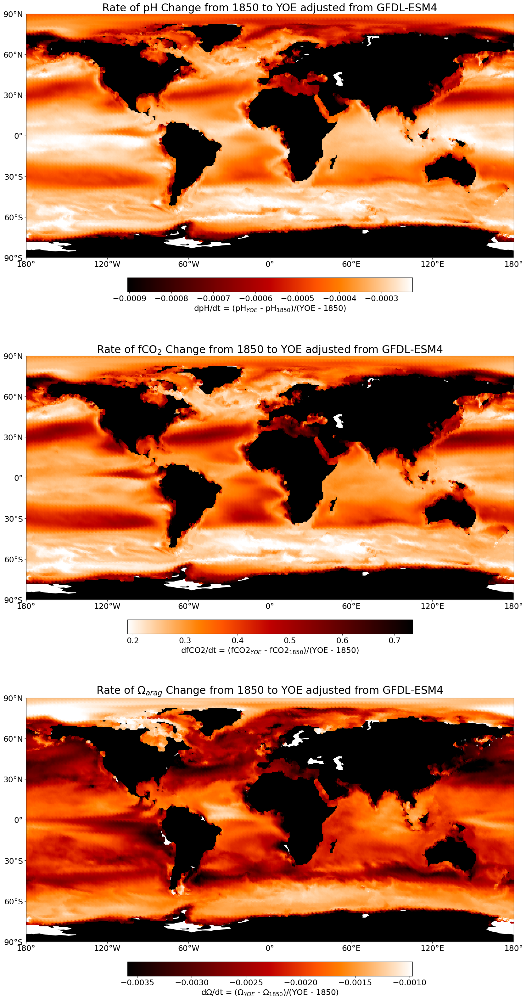

In [17]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})
import cartopy as cart
axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
ph = phgfdl
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = (ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)
yoe = ax.scatter(ph['Lon'], ph['Lat'], c= C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dpH/dt = (pH$_{YOE}$ - pH$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of pH Change from 1850 to YOE adjusted from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')
# addregions(ax, 'GFDL pH YOE ∆T/∆t')


# FCO2
ax = axarr[1]
fco2 = fco2gfdl
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = (fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)
yoe = ax.scatter(fco2['Lon'], fco2['Lat'], c= C, cmap = 'gist_heat_r', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dfCO2/dt = (fCO2$_{YOE}$ - fCO2$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of fCO$_2$ Change from 1850 to YOE adjusted from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL fCO2 YOE ∆T/∆t'
# addregions(ax,txt)

# OMEGA
ax = axarr[2]
omega = omegagfdl
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = (omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)
yoe = ax.scatter(omega['Lon'], omega['Lat'], c=C, cmap = 'gist_heat', vmin = C.quantile(0.01), vmax = C.quantile(0.99))
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('dΩ/dt = (Ω$_{YOE}$ - Ω$_{1850}$)/(YOE - 1850)')
ax.set_title('Rate of Ω$_{arag}$ Change from 1850 to YOE adjusted from GFDL-ESM4', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')
# txt = 'GFDL Ω YOE ∆T/∆t'
# addregions(ax,txt)

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/rateofchange_GFDL_label.png', bbox_inches='tight')

In [20]:
ph = phgfdl
fco2 = fco2gfdl
omega = omegagfdl

dP_dt_gfdl = ((ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)).std(ddof=1)
dF_dt_gfdl = ((fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)).std(ddof=1)
dO_dt_gfdl = ((omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)).std(ddof=1)

ph = phbuoy
fco2 = fco2buoy
omega = omegabuoy

dP_dt_buoy = ((ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)).std(ddof=1)
dF_dt_buoy = ((fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)).std(ddof=1)
dO_dt_buoy = ((omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)).std(ddof=1)

ph = phsocat
fco2 = fco2socat
omega = omegasocat

dP_dt_socat = ((ph['YOE Projected pH'] - ph['1850 pH'])/(ph['YOE']-1850)).std(ddof=1)
dF_dt_socat = ((fco2['YOE Projected fCO2'] - fco2['1850 fCO2'])/(fco2['YOE']-1850)).std(ddof=1)
dO_dt_socat = ((omega['YOE Projected Omega'] - omega['1850 Omega'])/(omega['YOE']-1850)).std(ddof=1)

temp = {'dpH/dt SOCAT': [dP_dt_socat], 
        'dfCO2/dt SOCAT': [dF_dt_socat],
        'dΩ/dt SOCAT': [dO_dt_socat],
        'dpH/dt Buoy': [dP_dt_buoy], 
        'dfCO2/dt Buoy': [dF_dt_buoy],
        'dΩ/dt Buoy': [dO_dt_buoy],
        'dpH/dt GFDL': [dP_dt_gfdl], 
        'dfCO2/dt GFDL': [dF_dt_gfdl],
        'dΩ/dt GFDL': [dO_dt_gfdl]}
pd.DataFrame(temp)

,dpH/dt SOCAT,dfCO2/dt SOCAT,dΩ/dt SOCAT,dpH/dt Buoy,dfCO2/dt Buoy,dΩ/dt Buoy,dpH/dt GFDL,dfCO2/dt GFDL,dΩ/dt GFDL
0,0.000129,0.081528,0.000527,0.000174,0.13687,0.000568,0.000135,0.11428,0.000586


In [38]:
NOISE = pd.read_csv('/Users/akbaskind/Desktop/YoE/NOISE_GFDL.csv')
NOISE2 = pd.read_csv('/Users/akbaskind/Desktop/YoE/NOISE_092123.csv')

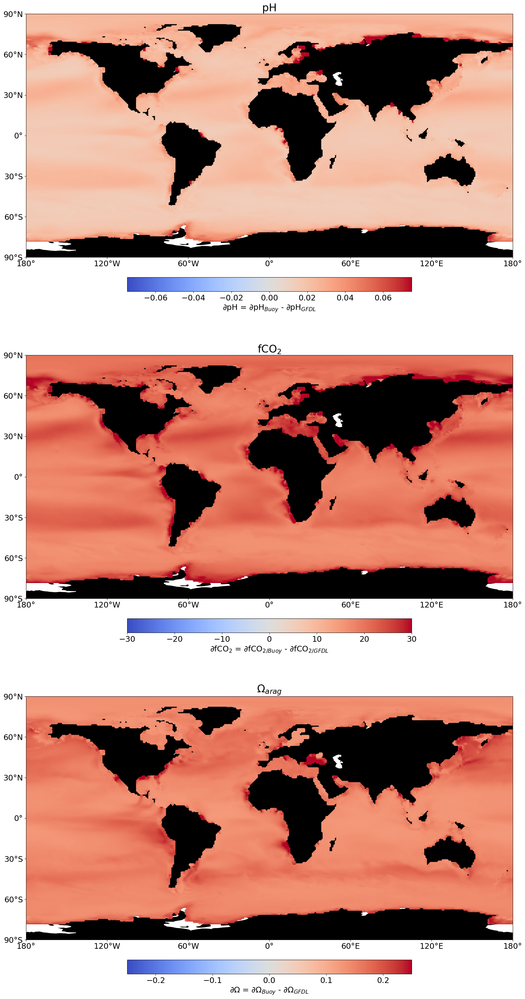

In [41]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})

axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
# Plot of mean detrended pH
C = NOISE2['Buoy Noise pH'] - NOISE['Noise pH']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -0.075, vmax = 0.075)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂pH = ∂pH$_{Buoy}$ - ∂pH$_{GFDL}$')
ax.set_title('pH', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')

# FCO2
ax = axarr[1]
# Plot of mean detrended pH
C = NOISE2['Buoy Noise fCO2'] - NOISE['Noise fCO2']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -30, vmax = 30)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂fCO$_2$ = ∂fCO$_{2/ Buoy}$ - ∂fCO$_{2/ GFDL}$')
ax.set_title('fCO$_2$', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')

# OMEGA
ax = axarr[2]
# Plot of mean detrended pH
C = NOISE2['Buoy Noise Omega'] - NOISE['Noise Omega']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -0.25, vmax = 0.25)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂Ω = ∂Ω$_{Buoy}$ - ∂Ω$_{GFDL}$')
ax.set_title('Ω$_{arag}$', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/diffVAR_GFDL_BUOY.png', bbox_inches='tight')

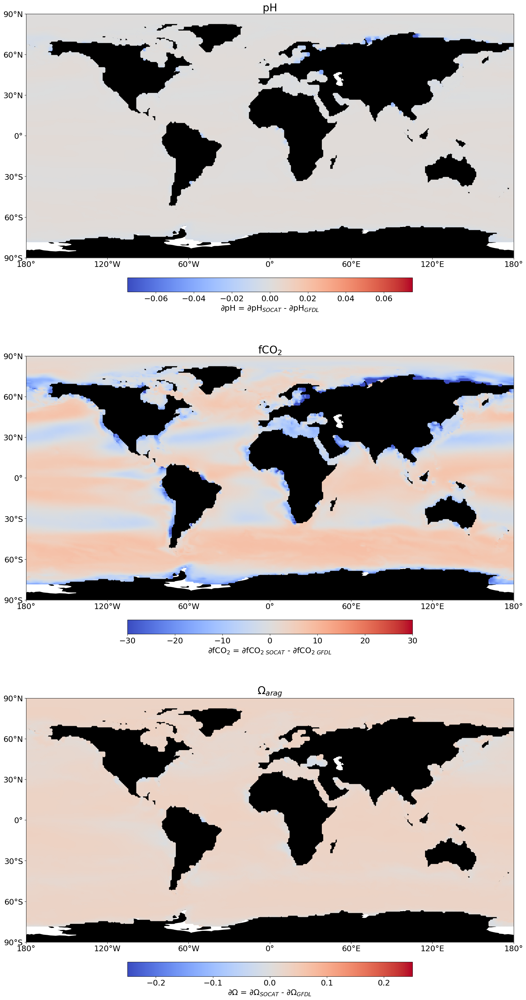

In [42]:
fig, axarr = plt.subplots(nrows = 3, figsize = [20,40],subplot_kw={'projection':ccrs.PlateCarree()})

axarr = axarr.flatten()
plt.rcParams.update({'font.size': 18})
plt.rc('xtick', labelsize=18)
plt.rc('ytick', labelsize=18)

# PH
ax = axarr[0]
# Plot of mean detrended pH
x,y = np.meshgrid(ph['Lon'], ph['Lat'])
C = NOISE2['SOCAT Noise pH'] - NOISE['Noise pH']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -0.075, vmax = 0.075)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂pH = ∂pH$_{SOCAT}$ - ∂pH$_{GFDL}$')
ax.set_title('pH', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
# ax.coastlines()
ax.add_feature(cart.feature.LAND, facecolor='black')

# FCO2
ax = axarr[1]
# Plot of mean detrended pH
x,y = np.meshgrid(fco2['Lon'], fco2['Lat'])
C = NOISE2['SOCAT Noise fCO2'] - NOISE['Noise fCO2']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -30, vmax = 30)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂fCO$_2$ = ∂fCO$_{2\ SOCAT}$ - ∂fCO$_{2\ GFDL}$')
ax.set_title('fCO$_2$', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')

# OMEGA
ax = axarr[2]
# Plot of mean detrended pH
x,y = np.meshgrid(omega['Lon'], omega['Lat'])
C = NOISE2['SOCAT Noise Omega'] - NOISE['Noise Omega']
yoe = ax.scatter(NOISE['Lon'], NOISE['Lat'], c= C, cmap = 'coolwarm', vmin = -0.25, vmax = 0.25)
cbar0 = plt.colorbar(yoe, ax = ax, orientation = 'horizontal', fraction = 0.05, pad = 0.07)
cbar0.set_label('∂Ω = ∂Ω$_{SOCAT}$ - ∂Ω$_{GFDL}$')
ax.set_title('Ω$_{arag}$', fontsize = 24)
ax.set_xticks(np.arange(-180,181,60), crs=ccrs.PlateCarree())
lon_formatter = cticker.LongitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.set_yticks(np.arange(-90,91,30), crs=ccrs.PlateCarree())
lat_formatter = cticker.LatitudeFormatter()
ax.yaxis.set_major_formatter(lat_formatter)
ax.add_feature(cart.feature.LAND, facecolor='black')

fig.savefig('/Users/akbaskind/Documents/Python Scripts/YoE/diffVAR_GFDL_SOCAT.png', bbox_inches='tight')

,Unnamed: 0,Lat,Lon,1850 Omega,YOE Projected Omega,YOE Actual Omega from polynomial,YOE,1850 T,YOE T,Noise
0,0,-70.5,0.5,1.876329,1.367711,1.366718,2049.0,-1.575847,-1.626151,0.254309
1,1,-69.5,0.5,1.804165,1.447841,1.442666,2030.0,-1.573529,-1.081146,0.178162
2,2,-68.5,0.5,1.716700,1.498388,1.496197,2007.0,-1.384377,-1.048249,0.109156
3,3,-67.5,0.5,1.727352,1.498421,1.496035,2008.0,-1.214233,-0.926476,0.114465
4,4,-66.5,0.5,1.740176,1.520664,1.517781,2005.0,-1.093688,-0.889281,0.109756
...,...,...,...,...,...,...,...,...,...,...
44559,44559,85.5,359.5,1.928166,1.725093,1.720837,1983.0,-1.731460,-1.713156,0.101536
44560,44560,86.5,359.5,1.951481,1.761090,1.758171,1981.0,-1.734834,-1.720549,0.095196
44561,44561,87.5,359.5,1.959827,1.786195,1.782057,1981.0,-1.733246,-1.725972,0.086816
44562,44562,88.5,359.5,1.952229,1.787712,1.784329,1983.0,-1.726650,-1.730383,0.082259


In [44]:
C

0        0.008154
1       -0.004759
2       -0.003392
3       -0.002372
4       -0.002182
           ...   
44559    0.031472
44560    0.031473
44561    0.031476
44562    0.031478
44563    0.031480
Length: 44564, dtype: float64

In [60]:
omega = omegagfdl
omega['∆T'] = omega['YOE T'] - omega['1850 T']
omega['dTdt'] = (omega['YOE T'] - omega['1850 T'])/(omega['YOE'] - 1850)
omega['∆Ω'] = omega['YOE Actual Omega from polynomial'] - omega['1850 Omega']
omega['dΩdt'] = (omega['YOE Actual Omega from polynomial'] - omega['1850 Omega'])/(omega['YOE'] - 1850)

In [48]:
np.corrcoef(omega['∆T'],omega['∆Ω'])

array([[nan, nan],
       [nan, nan]])

<AxesSubplot:>

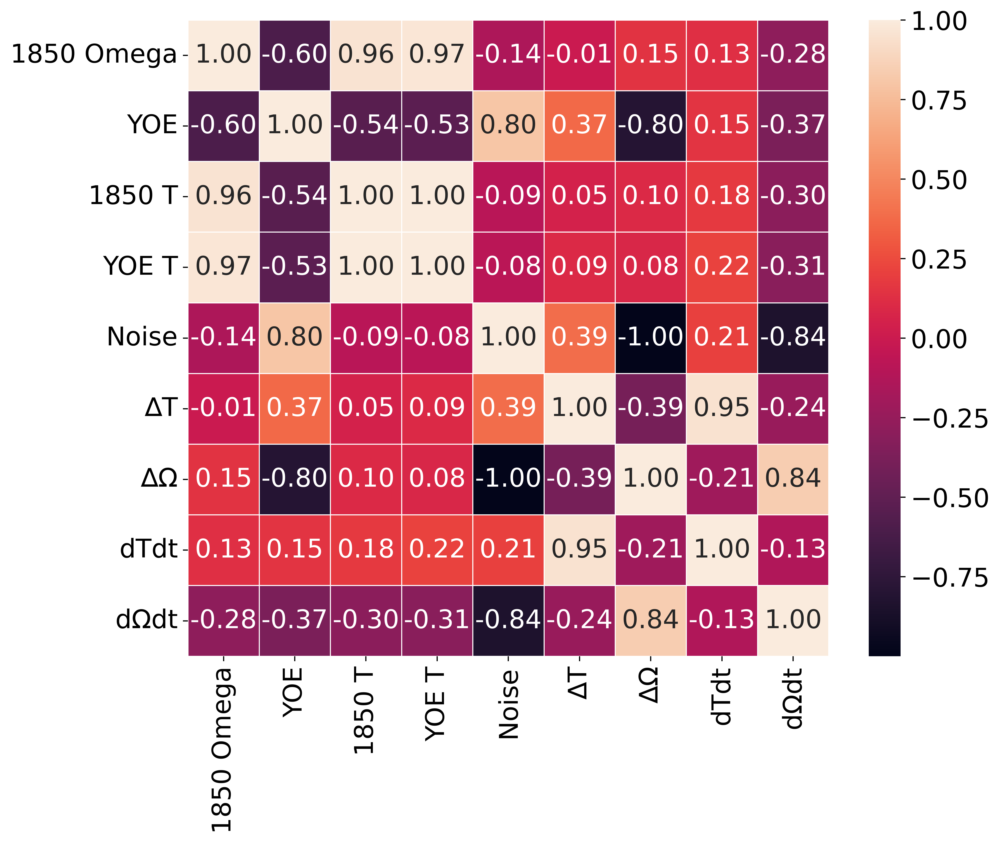

In [66]:
O = omega[['1850 Omega', 'YOE', '1850 T', 'YOE T', 'Noise',
       '∆T', '∆Ω', 'dTdt', 'dΩdt']]
corr = O.corr(method = 'pearson')
import seaborn as sns
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(corr,annot=True,fmt=".2f", linewidth=.5)

In [62]:
omega.keys()

Index(['Unnamed: 0', 'Lat', 'Lon', '1850 Omega', 'YOE Projected Omega',
       'YOE Actual Omega from polynomial', 'YOE', '1850 T', 'YOE T', 'Noise',
       '∆T', '∆Ω', 'dTdt', 'dΩdt'],
      dtype='object')